# Simulaciones de sistemas de muchas partículas

## Introducción

Resolver sistemas de ecuaciones diferenciales ordinarias nos dió las herramientas para poder simular una partícula en un potencial, incluso unas pocas partículas interactuando o bien ecuaciones de probabilidad (o poblaciones). Lo que después aprendimos sobre ecuaciones diferenciales parciales, nos sirvió para pasar de un problema temporal a uno espacial y poder simular sistemas continuos (como la ecuación de onda o de difusión). Esto es frecuentemente suficiente, pero no siempre. 

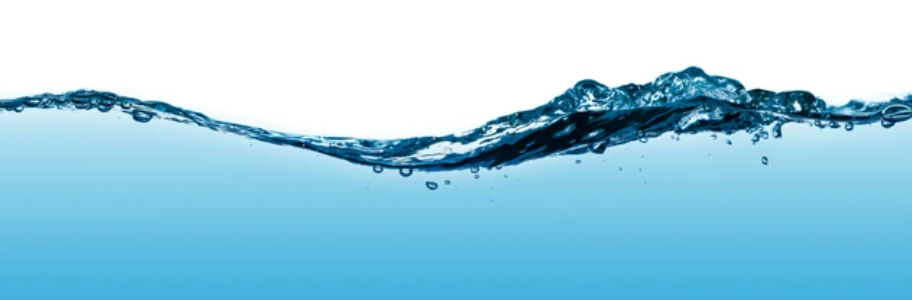

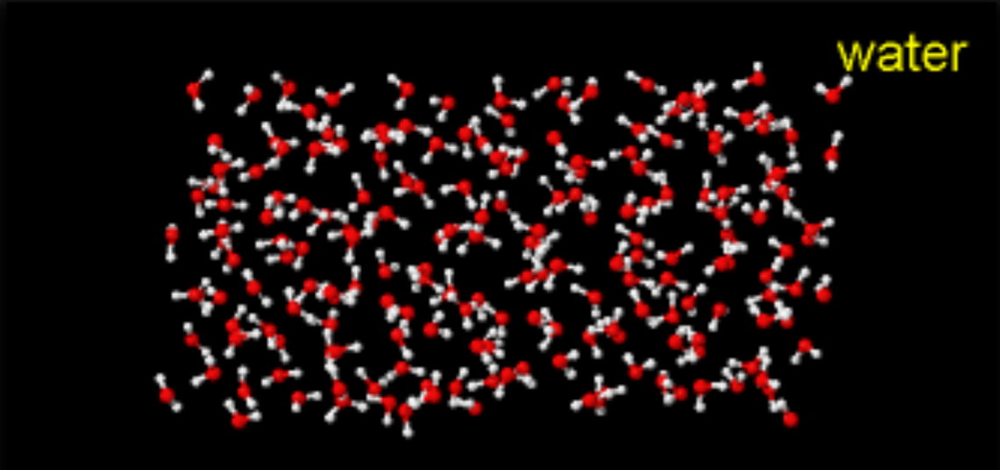

Muchas de las propiedades de los materiales o el comportamiento de sistemas complejos, son el resultado de interacciones locales entre partículas (o componentes del sistema), que al hacer un promedio obtenemos una propiedad macroscópica que es la que nos interesa. Es decir, a partir de modelos microscópicos de interacción, podemos obtener propiedades macroscópicas. Por ejemplo, la presión en un gas es el promedio de la fuerza de las moléculas estrellándose contra las paredes del recipiente. 

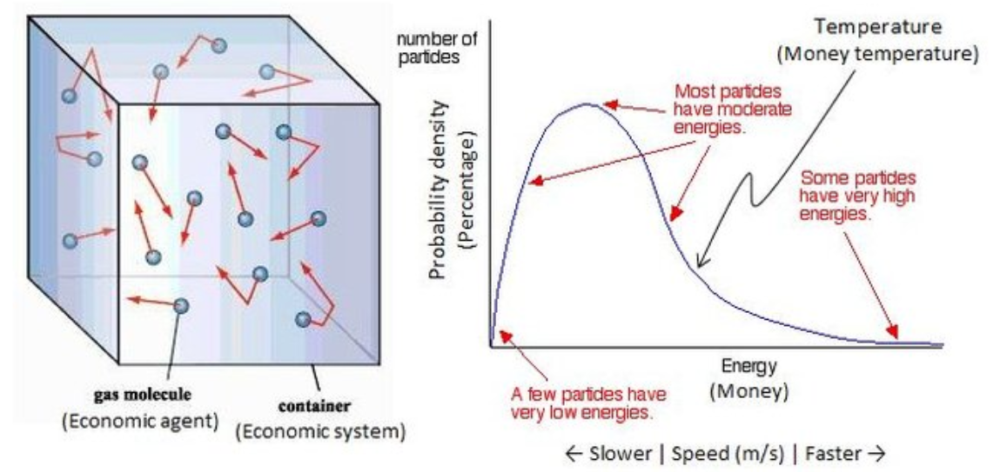

Pensando en esto, hay 3 métodos que se suelen usar para estudiar sistemas de muchas partículas: **Dinámica Molecular**, **Dinámica Browniana** y los algorítmos de **Monte-Carlo**. El primero de estos métodos trata sobre resolver de forma precisa la trayectoria de las partículas involucradas (vía resolver ecuaciones diferenciales) dado el potencial de interacción y un potencial externo y después se busca hacer los promedios correspondientes para obtener las propiedades macroscópicas. Dinámica Browniana es similar a dinámica molecular, excepto que en el potencial externo se considera un ruido aleatorio. 

Los **algoritmos de Monte-Carlo**, en cambio, buscan simular los sistemas macroscópicos pensando directamente que lo que se hará es un promedio y por lo tanto, sólo importa eso, el promedio. Así, para calcular una "trayectoria" o cualquier cosa de la que vayan a hacer un promedio, se valen de la probabilidad, "arrojando dados" que en promedio tengan las propiedades deseadas. 

Como los algoritmos de Monte-Carlo se basan en una cuestión probabilística y lanzar números aleatorios, uno automáticamente piensa en los juegos de azar y por lo tanto en los casinos. Como uno de los casinos más importantes en el mundo en la época en que se desarrollaron estos métodos era el casino de Monte-Carlo en Europa, se le llamaron a todos estos algoritmos, métodos de Monte-Carlo. 

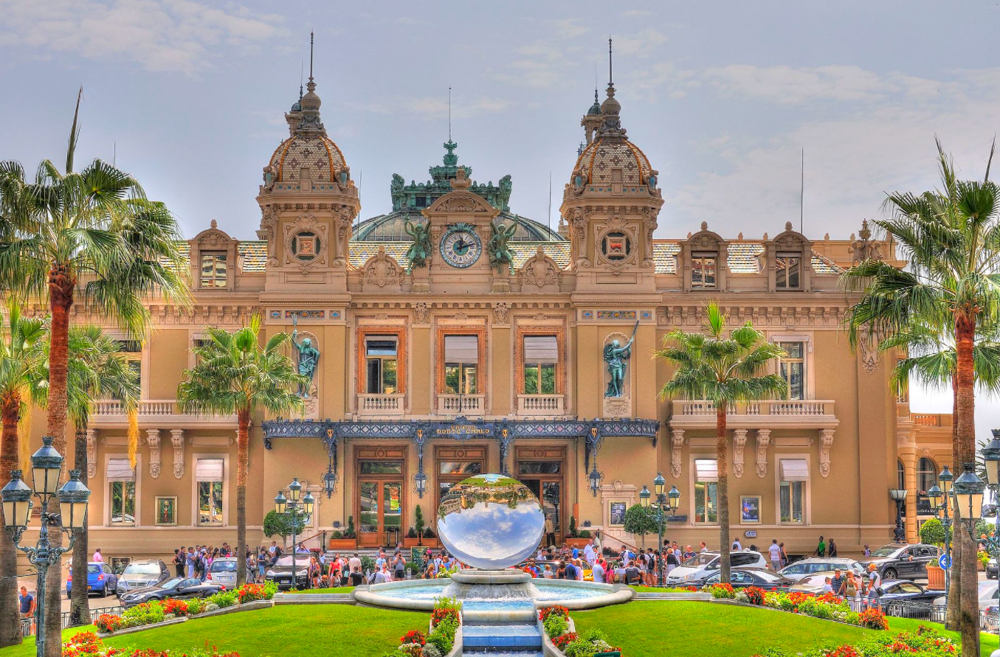

## Integrales

Para entender el cambio de enfoque pensemos que queremos calcular el área bajo la curva de alguna función $A = \int_a^b f(x) dx$: 

HTML{String}("<script>\n// Immediately-invoked-function-expression to avoid global variables.\n(function() {\n    var warning_div = document.getElementById(\"webio-warning-6371775930596949324\");\n    var hide = function () {\n        var script = document.getElementById(\"webio-setup-8661617168665706359\");\n        var parent = script && script.parentElement;\n        var grandparent = parent && parent.parentElement;\n        if (grandparent) {\n            grandparent.style.display = \"none\";\n        }\n        warning_div.style.display = \"none\";\n    };\n    if (typeof Jupyter !== \"undefined\") {\n        console.log(\"WebIO detected Jupyter notebook environment.\");\n        // Jupyter notebook.\n        var extensions = (\n            Jupyter\n            && Jupyter.notebook.config.data\n            && Jupyter.notebook.config.data.load_extensions\n        );\n        if (extensions && extensions[\"webio-jupyter-notebook\"]) {\n            // Extension already loaded.\n            console.log(\"Jupyter WebIO nbextension detected; not loading ad-hoc.\");\n            hide();\n            return;\n        }\n    } else if (window.location.pathname.includes(\"/lab\")) {\n        // Guessing JupyterLa\n        console.log(\"Jupyter Lab detected; make sure the @webio/jupyter-lab-provider labextension is installed.\");\n        hide();\n        return;\n    }\n})();\n\n</script>\n<p\n    id=\"webio-warning-6371775930596949324\"\n    class=\"output_text output_stderr\"\n    style=\"padding: 1em; font-weight: bold;\"\n>\n    Unable to load WebIO. Please make sure WebIO works for your Jupyter client.\n    For troubleshooting, please see <a href=\"https://juliagizmos.github.io/WebIO.jl/latest/providers/ijulia/\">\n    the WebIO/IJulia documentation</a>.\n    <!-- TODO: link to installation docs. -->\n</p>\n")

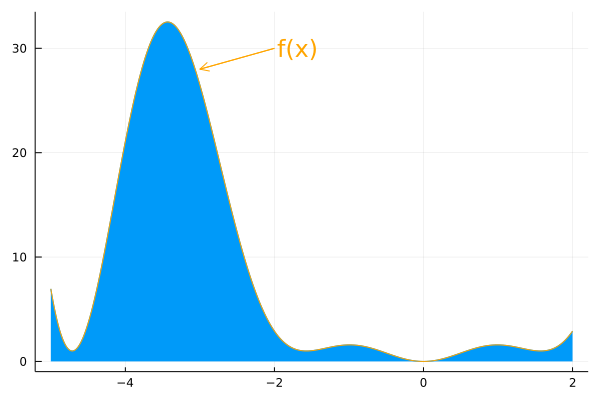

In [1]:
using Plots, LaTeXStrings, Interact
f(x) = sin(x)^2 + 3*x^2 * cos(x)^2
x = -5:0.01:2
plot(x, f.(x), fill= true, label = "")
plot!(x, f.(x), fill= false, color = :orange, label = "")
plot!([-2,-3], [30, 28], arrow = true, color = :orange, label = "")
annotate!([(-1.7, 30, ("f(x)", 16, :orange))])


Ya vimos que una opción es aproximar esta función por un polígono del que sabemos calcular el área. Una opción radicalmente diferente es "dispararle" aleatoriamente a este dibujo y contar, cuántos puntos disparos $n_A$ quedaron dentro del área $A$ y del total $n_t$ de disparos. Sabemos que $\frac{n_A}{n_t}$ es aproximadamente la probabilidad $p_A$ de atinarle al $A$, pero esa probabilidad es proporcional al área, de hecho $p = A/A_r$, donde $A_r$ es el área del rectángulo donde disparamos. Por lo tanto $A \approx A_r \frac{n_A}{n_t}$.  

In [2]:
function disparar!(f, xlim, ylim, n)
    Δx = xlim[2]-xlim[1]
    Δy = ylim[2]-ylim[1]
    contador = 0
    plot!(title = "disparos = $n")
    for i in 1:n
        x = xlim[1] + Δx*rand()
        y = ylim[1] + Δy*rand()
        if y <= f(x)
            contador += 1
            scatter!((x,y), markershape = :x, color = :orange, label = "", markersize = 2)
        else
            scatter!((x,y), markershape = :o, color = :black, label = "", markersize = 2)
        end
    end
    return contador, plot!([], [], xlim = xlim, ylim = ylim, key = false, color = :blue)
end

disparar! (generic function with 1 method)

In [23]:
x = -5:0.01:2
contadors = Observable([])
plot(x, f.(x), fill= true, label = "")
plot!(x, f.(x), fill= false, color = :orange, label = "")
plot!([-2,-3], [30, 28], arrow = true, color = :orange, label = "")
annotate!([(-1.7, 30, ("f(x)", 16, :orange))])
function disparar2(n,contador)
    contador2, plt = disparar!(f, [-5,2], [0, 40], 10)
    push!(contador, contador2)
    plot!(title = "disparos = $(10*n), Área = $(round(sum(contador)/(10*n)*40*7, digits = 4))")
end
disparos = button("10 disparos más", value = 1);

In [22]:
display(disparos)
map(disparar2, disparos.output, contadors)

(div { className="field interact-widget" }
    (button { attributes=Dict{Any, Any}("data-bind" => "click: function (){this.clicks(this.clicks()+1)}, css: {'is-loading' : loading}") className="is-medium button is-primary" style=Dict{String, Any}() }
    "10 disparos más"))

Observable{Any} with 0 listeners. Value:
Plot{Plots.GRBackend() n=14}

In [24]:
using SymPy

In [25]:
@vars x
ex = f(x) 
integrate(ex, (x,-5,2)).evalf()

54.2152277734417

La integración con este método no parece especialmente precisa, pero lo importante aquí es que es un nuevo tipo de algoritmo, totalmente diferente a los anteriores que de alguna forma (todos) usan sumas de Riemman. En este caso nos basamos en el concepto de probabilidad y el teorema de los números grandes (que dice que $p(x) \sim n_x /n_t$). 

Para generalizar este método y no tener dificultades con la elección del rectángulo, necesitamos recordar algunos conceptos de probabilidad. 

Una variable aleatoria es en realidad una función que va de un espacio muestral a los reales. El espacio muestral es cualquier conjunto. Lo importante es que esta clase de funciones nos arrojan números reales nuevos cada vez que "corremos" la variable aleatoria. Una pregunta natural es si $X$ es una variable aleatoria, con qué probabilidad saldrá un número específico. Si la variable aleatoria es continua, la probabilidad de que salga cualquier número es $0$, pero la probabilidad de que salga $x \in [a,b]$ puede ser diferente de 0. Para calcular esta probabilidad se requiere lo que se conoce como densidad de probabilidad $\rho_X(x)$ de la variable $X$. La probabilidad de obtener un número $x \in [a,b]$ dada la variable aleatoria $X$ es $\int_a^b \rho_X(x)dx$. 

Si conocemos $\rho_X(x)$, podemos calcular su integral, vía la variable aleatoria, pues esta probabilidad va a ser aproximadamente el número de veces que $X$ arroja un valor $x \in [a,b]$ dividido entre el número total de valores que arrojó $X$. 

Un resultado similar a esto, es que el valor esperado (el promedio) $\langle X \rangle$ de una variable aleatoria $X$ es: $\int_{-\infty}^{\infty} \rho_X(x)dx$. 

Por otro lado, al aplicar $g$ una función de $\mathbb{R} \rightarrow \mathbb{R}$, a una variable aleatoria $X$, obtenemos una nueva variable aleatoria $Y = g(X)$. El valor esperado de $Y$ $\langle Y \rangle$ es igual a $\int_{-\infty}^{\infty} g(x)\rho_X(x)dx$. 

Este resultado es súper importante, pues si $X$ por ejemplo es una variable aleatoria uniforme entre $0$ y $1$, entonces $\rho_X(x) = 1$ si $x \in [0,1]$ y $0$ en cualquier otro caso. Por lo tanto $\langle g(X) \rangle = \int_0^1 g(x)dx$. Es decir, haciendo el promedio de $g(x)$ usando $x = rand()$, podemos calcular la integral entre $0$ y $1$ de $g(x)$!!!

In [26]:
∫01(g, n) = sum(g.(rand(n)))/n

∫01 (generic function with 1 method)

In [11]:
∫01(f, 1000), integrate(ex, (x,0,1)).evalf()

(0.841356843482804, 0.801552050942853)

Nuevamente, no es que el método sea increíblemente bueno, pero es importante el cambio de paradigma. Aún así, cuando se trata de integrales múltiples, sí se puede volver más preciso el cálculo de las integrales usando este método probabilístico. La razón es que el volumen o hipervolumen que estemos calculando sigue siendo directamente proporcional a la probabilidad que sigue siendo directamente proporcional a $n_x/n_t$, mientras que las sumas de Riemman requieren cada vez más pasos de integración, pues estos crecen como una potencia de la dimensión de la integral. 

Regresando a nuestro problema original, queremos una integral $\int_a^b g(x)dx$ y no una de $0$ a $1$. Para hacer el cambio podemos usar un cambio de variable $\int_a^b g(x)dx = (b-a)\int_0^1 g(a-x(a-b))dx$. 

Es muy importante notar aquí que el error no es trivial medirlo en este caso, pues de hecho lo que se obtiene es una variable aleatoria, con una distribución de probabilidad parecida a una gaussiana (justo por el teorema del límite central), así que el error ya no es determinístico, sino probabilístico. Para cada error, hay una probabilidad de que nuestro resultado caiga en ese intervalo. 

In [27]:
∫(g,a,b, n) = (b-a) * sum(g.(a.-(a-b)*rand(n)))/n

∫ (generic function with 1 method)

In [28]:
∫(f, -5,2,10000), integrate(ex, (x,-5,2)).evalf()

(53.72495897817171, 54.2152277734417)

In [29]:
a = N(integrate(ex, (x,-5,2)).evalf())
h(n) = [∫(f, -5,2,30000)- a for i in 1:n]

h (generic function with 1 method)

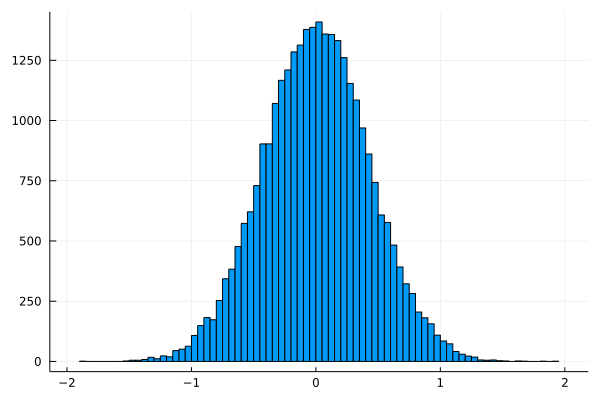

In [30]:
histogram(h(30000), nbins = 100, key = false)

hacer integrales múltiples es similar, sólo haciendo el cambio de variable adecuado. 

<br>
<br>
<br>
<br>
<br>
<br>

## Ecuaciones diferenciales parciales. 

Muchas ecuaciones diferenciales parciales se pueden interpretar como una ecuación probabilística. Por ejemplo consideremos la ecuación de Laplace: 

$$ \nabla^2 u  = 0$$ 

Esta ecuación la queremos resolver con ciertas condiciones de frontera $u(x',y') = f(x',y')$ donde $f$ es una función conocida (ver figura).  

Para interpretar la ecuación como un problema probabilístico, la escribimos en su forma en diferencias finitas (con la definición de derivada parcial). Es decir, 

$$ \frac{u(x+\Delta, y) + u(x-\Delta, y) +u(x, y+\Delta) + u(x, y-\Delta) - 4 u(x,y)}{\Delta^2} = 0$$

o bien: 

$$u(x,y) =  \frac{u(x+\Delta, y) + u(x-\Delta, y) +u(x, y+\Delta) + u(x, y-\Delta) }{4}$$

Esta forma de escribir la ecuación sugiere ver el plano $xy$ como una retícula con separación $\Delta$ entre un vértice de la retícula y sus vecinos (ver figura). 

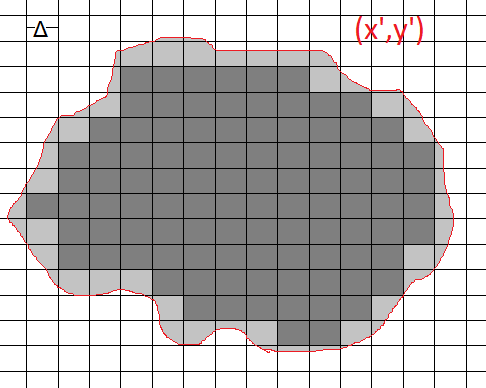

Ahora pensemos en partículas que se mueven sobre la red aleatoriamente de forma homogenea (caminantes aleatorios). Llamemos $u_0(x,y)$ la cantidad de partículas que hay en cada nodo de la red en el tiempo $t_0$. La cantidad de partículas en el tiempo $t_1$ en cada nodo será entonces en promedio: 

$$\frac{u_0(x+\Delta, y) + u_0(x-\Delta, y) +u_0(x, y+\Delta) + u_0(x, y-\Delta) }{4}$$

En el estado estacionario (si existe), se cumple que $u_n(x,y) = u_{n+1}(x,y)$ para todo par $(x,y)$. Por lo tanto, podemos pensar que la solución a la ecuación de Laplace se puede aproximar poniendo muchísimos caminantes aleatorios en la frontera con alguna probabilidad de ponerlos ahí (proporcional a $f(x',y')$) y revisando cuantos llegan al punto $(x,y)$, o equivalentemente, podemos poner muchas caminantes aleatorios en la posición $(x,y)$ inicialmente y esperar a que lleguen a la frontera. Dependiendo de a qué lugar de la forntera llegan, es el peso que tendrán en $(x,y)$. Es decir, $u(x,y)$ será un promedio pesado de las $u(x',y')$ de las fronteras a las que llegan las partículas. De hecho, directamente podemos aplicar la función $f$ obtieniendo: 

$$ u(x,y) \sim \frac{1}{N} \sum f(x',y'),$$

donde la suma se hace sobre los caminantes aleatorios. En este caso, la precisión de la solución depende de ambos, del tamaño de $\Delta$ (entre más pequeño, más fina la solución) y del número de caminantes aleatorios. 

### Código

Para hacer nuestra simulación voy a tomar directamente una imagen que represente una placa que se está calentando (la de la imagen). 

Con una imagen así resulta "fácil" definir las condiciones a la frontera. 

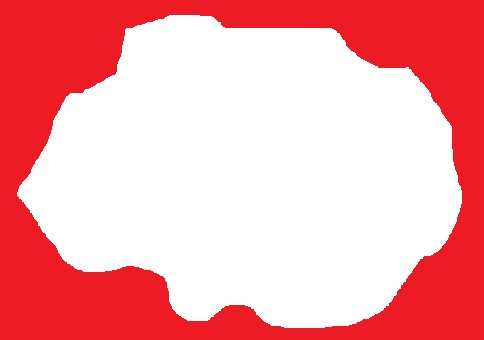

In [31]:
using Plots, Images
placa = load("placa.png")

n * m = 164560


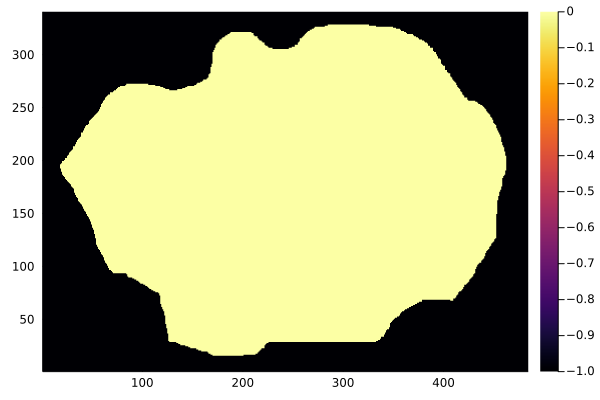

In [32]:
n,m = size(placa)
@show n*m
retícula = [placa[i,j] == placa[1,1] ? -1 : 0 for i in 1:n, j in 1:m]; 
heatmap(retícula)

La frontera son los pixeles (vértices de la red) que están en rojo y que son vecinos de un pixel blanco, o bien, en la retícula, son los elementos de la matriz que tienen como valor -1, pero que algún elemento vecino tiene como valor 0. 

Para hacer la simulación el primer paso es comenzar un caminante en la zona adecuada. 

In [33]:
function posicion_permitida(i,j, retícula)
    if retícula[i,j] == -1 
        return false
    else
        return true
    end
end

posicion_permitida (generic function with 1 method)

Con esta función podemos saber si nuestro caminante está en una posición permitida. Esta función la usamos tanto para revisar que inicialmente es un punto que debemos simular, como para checar si llegamos o no a la frontera. El siguiente paso es evolucionar al caminante. 

In [34]:
function evoluciona_caminante(i,j, retícula)
    n = rand([1,2,3,4])
    if n == 1 
        return i + 1, j
    elseif n == 2
        return i - 1, j
    elseif n == 3
        return i, j + 1
    elseif n == 4
        return i, j - 1
    end
end 

function trayectoria_hasta_salir!(i,j, retícula)
    test = true
    I = [i]
    J = [j]
    while test
        i,j = evoluciona_caminante(i,j, retícula)
        push!(I, i)
        push!(J, j)
        test = posicion_permitida(i,j, retícula)
    end
    return I, J
end 

trayectoria_hasta_salir! (generic function with 1 method)

Con estas funciones ya obtenemos para cada caminante en qué valor $(x',y')$ sale, pero de hecho tenemos más que eso, pues cada vértice por el que pasa es un lugar posible y todos ellos tienen esa trayectoria con esa salida. 

Entonces, sólo necesitamos llevar una cuenta en cada parte de la retícula, de cuantos caminantes efectivos llevamos. Cuando todos los puntos superen un número $n$ de caminantes efectivos, podemos detener la simulación. 

Para medir cuándo ya superamos ese mínimo, necesitamos primero que nada una función que encuentre dentro de la matriz el menor valor que sea mayor o igual a 0. 

In [35]:
function minimum_positivo(matriz)
    n,m = size(matriz)
    x = Inf
    for i in 1:n, j in 1:m
        if matriz[i,j]<x && matriz[i,j] >= 0
            x = matriz[i,j]
        end
    end
    if x ≠ Inf
        return x
    else
        return 0
    end 
end

minimum_positivo (generic function with 1 method)

Ahora sí, seguimos el algoritmo planteado antes para estimar la solución a la ecuación diferencial: 

In [36]:
function resuelve_Laplace(retícula, f, n)    
    contador = 0
    n1, n2 = size(retícula)
    solución = zeros(n1,n2)
    numero_de_caminantes = [retícula[i,j]<0 ? -1 : 0 for i in 1:n1, j in 1:n2]
    while minimum_positivo(numero_de_caminantes)<n
        for i in 1:n1, j in 1:n2
            contador += 1
            if mod(contador, 1500) == 0
                println("revisando vertice ($i ,$j)")
                println("numero maximo de caminantes = $(maximum(numero_de_caminantes))")
                println("numero mínimo de caminantes = $(minimum_positivo(numero_de_caminantes))")
                println(" ")
            end
            test = posicion_permitida(i,j, retícula)
            if test
                x,y = trayectoria_hasta_salir!(i,j,retícula)
                s = f(x[end], y[end])
                for k in 1:length(x)-1
                    solución[x[k],y[k]] += s
                    numero_de_caminantes[x[k],y[k]] += 1
                end
            end
        end
    end
    return solución, numero_de_caminantes
end

resuelve_Laplace (generic function with 1 method)

In [37]:
function mezcla_solucion_n(s, nc)  # Esta función simplemente sirve para hacer los promedios de la solución correctamente. 
    n,m = size(s)
    [nc[i,j] > 0 ? s[i,j]/nc[i,j] : NaN for i in 1:n, j in 1:m]
end

mezcla_solucion_n (generic function with 1 method)

In [38]:
f(y,x) = 1/(y+1)
@time solución, numero_de_caminantes = resuelve_Laplace(retícula, f, 10)

revisando vertice (4 ,48)
numero maximo de caminantes = 0
numero mínimo de caminantes = 0
 
revisando vertice (7 ,96)
numero maximo de caminantes = 0
numero mínimo de caminantes = 0
 
revisando vertice (10 ,144)
numero maximo de caminantes = 0
numero mínimo de caminantes = 0
 
revisando vertice (13 ,192)
numero maximo de caminantes = 0
numero mínimo de caminantes = 0
 
revisando vertice (16 ,240)
numero maximo de caminantes = 16
numero mínimo de caminantes = 0
 
revisando vertice (19 ,288)
numero maximo de caminantes = 66
numero mínimo de caminantes = 0
 
revisando vertice (22 ,336)
numero maximo de caminantes = 115
numero mínimo de caminantes = 0
 
revisando vertice (25 ,384)
numero maximo de caminantes = 222
numero mínimo de caminantes = 0
 
revisando vertice (28 ,432)
numero maximo de caminantes = 355
numero mínimo de caminantes = 0
 
revisando vertice (31 ,480)
numero maximo de caminantes = 454
numero mínimo de caminantes = 0
 
revisando vertice (35 ,44)
numero maximo de caminantes

revisando vertice (264 ,208)
numero maximo de caminantes = 28959
numero mínimo de caminantes = 36
 
revisando vertice (267 ,256)
numero maximo de caminantes = 29096
numero mínimo de caminantes = 36
 
revisando vertice (270 ,304)
numero maximo de caminantes = 29272
numero mínimo de caminantes = 36
 
revisando vertice (273 ,352)
numero maximo de caminantes = 29373
numero mínimo de caminantes = 36
 
revisando vertice (276 ,400)
numero maximo de caminantes = 29505
numero mínimo de caminantes = 36
 
revisando vertice (279 ,448)
numero maximo de caminantes = 29591
numero mínimo de caminantes = 36
 
revisando vertice (283 ,12)
numero maximo de caminantes = 29713
numero mínimo de caminantes = 36
 
revisando vertice (286 ,60)
numero maximo de caminantes = 29787
numero mínimo de caminantes = 36
 
revisando vertice (289 ,108)
numero maximo de caminantes = 29871
numero mínimo de caminantes = 36
 
revisando vertice (292 ,156)
numero maximo de caminantes = 29935
numero mínimo de caminantes = 36
 
re

([0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], [-1 -1 … -1 -1; -1 -1 … -1 -1; … ; -1 -1 … -1 -1; -1 -1 … -1 -1])

In [39]:
@show maximum(numero_de_caminantes), minimum_positivo(numero_de_caminantes)
ss = mezcla_solucion_n(solución, numero_de_caminantes);

(maximum(numero_de_caminantes), minimum_positivo(numero_de_caminantes)) = (30230, 36)


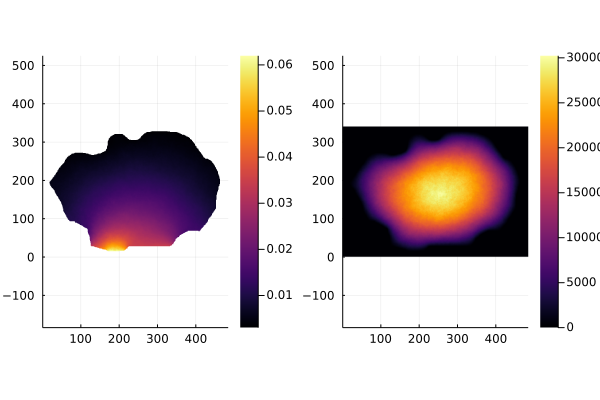

In [40]:
heatp = heatmap(numero_de_caminantes, aspect_ratio = :equal)
heatT = heatmap(ss, aspect_ratio = :equal)
plot(heatT, heatp)

Esto lo hace bien, pero como los caminantes no visitan parejo todos los vértices, donde se tinen pocas visitas se podría pensar que el ruido será mayor. 

Una forma muestrear más homogeneamente, es elegir aleatoriamente el vértice de inicio y sólo entre los vértices que hayan sido visitado menos. Es decir, tomar todos los vértices cuyo número de visitas sea igual al número mínimo de visitas, excluyendo los vértices que no pueden ser visitados. 

Para esto primero necesitamos definir una función que encuentre todos los mínimos que sean mayores o iguales a 0: 

In [46]:
function minimos_positivos(matriz)
    y = minimum_positivo(matriz)
    I = findall(x-> x == y, matriz);
end

function minimos_positivos(matriz, mini)
    I = findall(x-> x == mini, matriz)  
end

minimos_positivos (generic function with 2 methods)

In [47]:
function resuelve_Laplace_h(retícula, f, n)    
    contador = 0
    n1, n2 = size(retícula)
    solución = zeros(n1,n2)
    numero_de_caminantes = [retícula[i,j]<0 ? -1 : 0 for i in 1:n1, j in 1:n2]
    mini = 0
    I = minimos_positivos(numero_de_caminantes)
    while minimum_positivo(numero_de_caminantes)<n+1
        if mini == 0 && contador > 0
            I = minimos_positivos(numero_de_caminantes)
            mini = numero_de_caminantes[I[1]]
        elseif mini>0
            I = minimos_positivos(numero_de_caminantes, mini)
            if length(I) == 0
                I = minimos_positivos(numero_de_caminantes)
            end
            mini = numero_de_caminantes[I[1]]
        end
        j = rand(I)
        contador += 1
        if mod(contador, 5000) == 0
            println("revisando vertice ($(j[1]) ,$(j[2]))")
            println("numero maximo de caminantes = $(maximum(numero_de_caminantes))")
            println("numero mínimo de caminantes = $(minimum_positivo(numero_de_caminantes))")
            println(" ")
        end
        test = posicion_permitida(j[1],j[2], retícula)
        if test
            x,y = trayectoria_hasta_salir!(j[1],j[2],retícula)
            s = f(x[end], y[end])
            for k in 1:length(x)-1
                solución[x[k],y[k]] += s
                numero_de_caminantes[x[k],y[k]] += 1
            end
        end
    
    end
    return solución, numero_de_caminantes
end

resuelve_Laplace_h (generic function with 1 method)

In [48]:
dg = load("placa2.png")
n,m = size(dg)
@show n*m
retícula = [dg[i,j] == dg[1,end] ? -1 : 0 for i in 1:n, j in 1:m]; 


n * m = 204756


In [49]:
function f(x,y)
    if (150<y<385 && 100<x<310) || (300<x<400 && 80<y<135)
        return 10
    else
        return 1
    end
end

f (generic function with 2 methods)

In [50]:
@time solución, numero_de_caminantes = resuelve_Laplace_h(retícula, f, 1000)

revisando vertice (432 ,101)
numero maximo de caminantes = 117
numero mínimo de caminantes = 3
 
revisando vertice (239 ,214)
numero maximo de caminantes = 151
numero mínimo de caminantes = 8
 
revisando vertice (407 ,67)
numero maximo de caminantes = 171
numero mínimo de caminantes = 14
 
revisando vertice (282 ,228)
numero maximo de caminantes = 196
numero mínimo de caminantes = 19
 
revisando vertice (233 ,353)
numero maximo de caminantes = 212
numero mínimo de caminantes = 24
 
revisando vertice (324 ,379)
numero maximo de caminantes = 219
numero mínimo de caminantes = 30
 
revisando vertice (167 ,286)
numero maximo de caminantes = 223
numero mínimo de caminantes = 35
 
revisando vertice (257 ,237)
numero maximo de caminantes = 234
numero mínimo de caminantes = 40
 
revisando vertice (240 ,225)
numero maximo de caminantes = 245
numero mínimo de caminantes = 46
 
revisando vertice (144 ,297)
numero maximo de caminantes = 262
numero mínimo de caminantes = 51
 
revisando vertice (170 

 
revisando vertice (144 ,264)
numero maximo de caminantes = 972
numero mínimo de caminantes = 450
 
revisando vertice (298 ,307)
numero maximo de caminantes = 974
numero mínimo de caminantes = 455
 
revisando vertice (420 ,116)
numero maximo de caminantes = 979
numero mínimo de caminantes = 461
 
revisando vertice (297 ,48)
numero maximo de caminantes = 983
numero mínimo de caminantes = 466
 
revisando vertice (284 ,47)
numero maximo de caminantes = 994
numero mínimo de caminantes = 471
 
revisando vertice (415 ,122)
numero maximo de caminantes = 1010
numero mínimo de caminantes = 477
 
revisando vertice (7 ,244)
numero maximo de caminantes = 1010
numero mínimo de caminantes = 482
 
revisando vertice (278 ,321)
numero maximo de caminantes = 1020
numero mínimo de caminantes = 487
 
revisando vertice (284 ,220)
numero maximo de caminantes = 1021
numero mínimo de caminantes = 493
 
revisando vertice (160 ,247)
numero maximo de caminantes = 1027
numero mínimo de caminantes = 498
 
revisan

revisando vertice (45 ,10)
numero maximo de caminantes = 1566
numero mínimo de caminantes = 891
 
revisando vertice (234 ,342)
numero maximo de caminantes = 1566
numero mínimo de caminantes = 896
 
revisando vertice (250 ,210)
numero maximo de caminantes = 1568
numero mínimo de caminantes = 902
 
revisando vertice (358 ,102)
numero maximo de caminantes = 1573
numero mínimo de caminantes = 907
 
revisando vertice (242 ,239)
numero maximo de caminantes = 1585
numero mínimo de caminantes = 912
 
revisando vertice (274 ,236)
numero maximo de caminantes = 1594
numero mínimo de caminantes = 917
 
revisando vertice (449 ,300)
numero maximo de caminantes = 1595
numero mínimo de caminantes = 923
 
revisando vertice (375 ,173)
numero maximo de caminantes = 1600
numero mínimo de caminantes = 928
 
revisando vertice (214 ,32)
numero maximo de caminantes = 1601
numero mínimo de caminantes = 933
 
revisando vertice (164 ,299)
numero maximo de caminantes = 1601
numero mínimo de caminantes = 939
 
rev

([0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], [-1 -1 … -1 -1; -1 -1 … -1 -1; … ; -1 -1 … -1 -1; -1 -1 … -1 -1])

In [51]:
@time solución2, numero_de_caminantes2 = resuelve_Laplace(retícula, f, 10)

revisando vertice (4 ,141)
numero maximo de caminantes = 0
numero mínimo de caminantes = 0
 
revisando vertice (7 ,282)
numero maximo de caminantes = 40
numero mínimo de caminantes = 0
 
revisando vertice (10 ,423)
numero maximo de caminantes = 105
numero mínimo de caminantes = 0
 
revisando vertice (14 ,111)
numero maximo de caminantes = 200
numero mínimo de caminantes = 0
 
revisando vertice (17 ,252)
numero maximo de caminantes = 331
numero mínimo de caminantes = 0
 
revisando vertice (20 ,393)
numero maximo de caminantes = 498
numero mínimo de caminantes = 0
 
revisando vertice (24 ,81)
numero maximo de caminantes = 764
numero mínimo de caminantes = 0
 
revisando vertice (27 ,222)
numero maximo de caminantes = 961
numero mínimo de caminantes = 0
 
revisando vertice (30 ,363)
numero maximo de caminantes = 1256
numero mínimo de caminantes = 0
 
revisando vertice (34 ,51)
numero maximo de caminantes = 1477
numero mínimo de caminantes = 0
 
revisando vertice (37 ,192)
numero maximo de 

revisando vertice (282 ,207)
numero maximo de caminantes = 20728
numero mínimo de caminantes = 0
 
revisando vertice (285 ,348)
numero maximo de caminantes = 20744
numero mínimo de caminantes = 0
 
revisando vertice (289 ,36)
numero maximo de caminantes = 20758
numero mínimo de caminantes = 0
 
revisando vertice (292 ,177)
numero maximo de caminantes = 20766
numero mínimo de caminantes = 0
 
revisando vertice (295 ,318)
numero maximo de caminantes = 20779
numero mínimo de caminantes = 0
 
revisando vertice (299 ,6)
numero maximo de caminantes = 20808
numero mínimo de caminantes = 0
 
revisando vertice (302 ,147)
numero maximo de caminantes = 20819
numero mínimo de caminantes = 0
 
revisando vertice (305 ,288)
numero maximo de caminantes = 20827
numero mínimo de caminantes = 0
 
revisando vertice (308 ,429)
numero maximo de caminantes = 20838
numero mínimo de caminantes = 0
 
revisando vertice (312 ,117)
numero maximo de caminantes = 20838
numero mínimo de caminantes = 0
 
revisando ver

revisando vertice (108 ,273)
numero maximo de caminantes = 29415
numero mínimo de caminantes = 2
 
revisando vertice (111 ,414)
numero maximo de caminantes = 29858
numero mínimo de caminantes = 2
 
revisando vertice (115 ,102)
numero maximo de caminantes = 30305
numero mínimo de caminantes = 2
 
revisando vertice (118 ,243)
numero maximo de caminantes = 30873
numero mínimo de caminantes = 2
 
revisando vertice (121 ,384)
numero maximo de caminantes = 31366
numero mínimo de caminantes = 2
 
revisando vertice (125 ,72)
numero maximo de caminantes = 31858
numero mínimo de caminantes = 2
 
revisando vertice (128 ,213)
numero maximo de caminantes = 32302
numero mínimo de caminantes = 2
 
revisando vertice (131 ,354)
numero maximo de caminantes = 32709
numero mínimo de caminantes = 2
 
revisando vertice (135 ,42)
numero maximo de caminantes = 33069
numero mínimo de caminantes = 2
 
revisando vertice (138 ,183)
numero maximo de caminantes = 33521
numero mínimo de caminantes = 2
 
revisando ve

revisando vertice (383 ,198)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (386 ,339)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (390 ,27)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (393 ,168)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (396 ,309)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (399 ,450)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (403 ,138)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (406 ,279)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (409 ,420)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
revisando vertice (413 ,108)
numero maximo de caminantes = 41327
numero mínimo de caminantes = 10
 
r

([0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], [-1 -1 … -1 -1; -1 -1 … -1 -1; … ; -1 -1 … -1 -1; -1 -1 … -1 -1])

In [56]:
sum(numero_de_caminantes)/631, sum(numero_de_caminantes2)/222

(268503.824088748, 8.308006689189189e6)

In [62]:
s_dg = mezcla_solucion_n(solución, numero_de_caminantes);
s_dg2 = mezcla_solucion_n(solución2, numero_de_caminantes2);
n,m = size(s_dg)
s_dgf = [s_dg[i,j] == 0 ? f(i,j) : s_dg[i,j] for i in 1:n, j in 1:m]
s_dgf2 = [s_dg2[i,j] == 0 ? f(i,j) : s_dg2[i,j] for i in 1:n, j in 1:m];

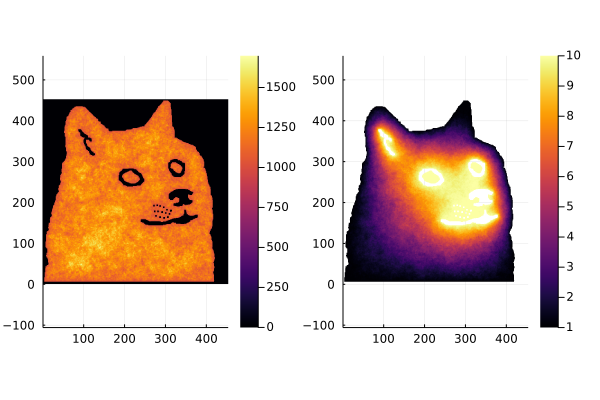

In [63]:
heat_pdg = heatmap(numero_de_caminantes, aspect_ratio = :equal)
heat_Tdg = heatmap(s_dgf, aspect_ratio = :equal)
plot(heat_pdg, heat_Tdg)

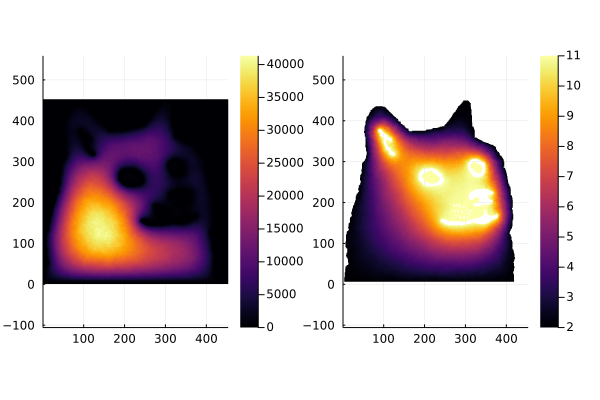

In [59]:
heat_pdg2 = heatmap(numero_de_caminantes2, aspect_ratio = :equal)
heat_Tdg2 = heatmap(s_dgf2, aspect_ratio = :equal)
plot(heat_pdg2, heat_Tdg2)

Como se ve, de hecho es más rápido y mejor el método donde dejamos que los muestreos no sean parejos. La razón es que en realidad donde hay pocas visitas, es porque la probabilidad de caer en un conjunto pequeño de lugares de la frontera es muy alto, por lo que al hacer el promedio, en realidad no requerimos un muestreo tan grande. En cambio, los vértices que tienen una probabilidad casi homogenea de caer en cualquier lugar de la frontera tienen fluctuaciones mucho mayores y por lo tanto requieren un muestreo mayor para reducir esas fluctuaciones. 

<br>
<br>
<br>
<br>
<br>
<br>

## Algoritmo de Metrópolis

### Probabilidad condicional

Los cálculos de probabilidad de algún evento, pueden estimarse considerando todas las posibles situaciones y revisando entre estas en cuales sucede dicho evento. Por ejemplo, para calcular la probabilidad de que la suma de lo que sale de tirar 2 dados de 8, lo que se hace es notar que hay 5 casos donde la suma da 8 de entre 36 posibles situaciones, lo que da una probabilidad de $5/36$. Esto claro, si el dado es ideal. 

En muchos casos la probabilidad de que un evento suceda es sumamente pequeña y uno puede pensar que es básicamente imposible; sin embargo, cuando uno tiene información extra, puede concluir que no es tan improbable. También lo opuesto, a veces un evento parece probable, pero cuando tenemos más información sobre el caso, concluimos que es improbable. Por ejemplo, ¿cuále es la probabilidad de que una persona muera de diarrea? Suena una probabilidad muy baja, pero si agregamos que esa persona tiene entre 0 y 1 año de edad, la probabilidad se incrementa considerablemente. Cuando el cálculo de una probabilidad se hace utilizando información extra, hablamos de una probabilidad condicional y la escribimos como $p(x|y)$ que significa, la probabilidad de que ocurra $x$ dado que ocurrió $y$. 

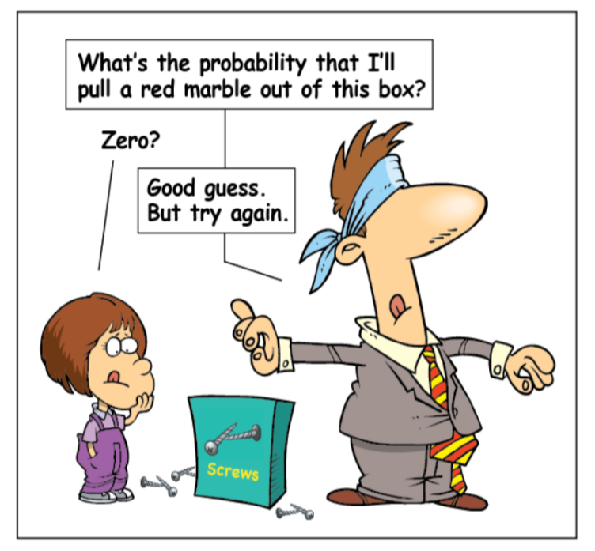

### Probabilidad de brincar entre estados

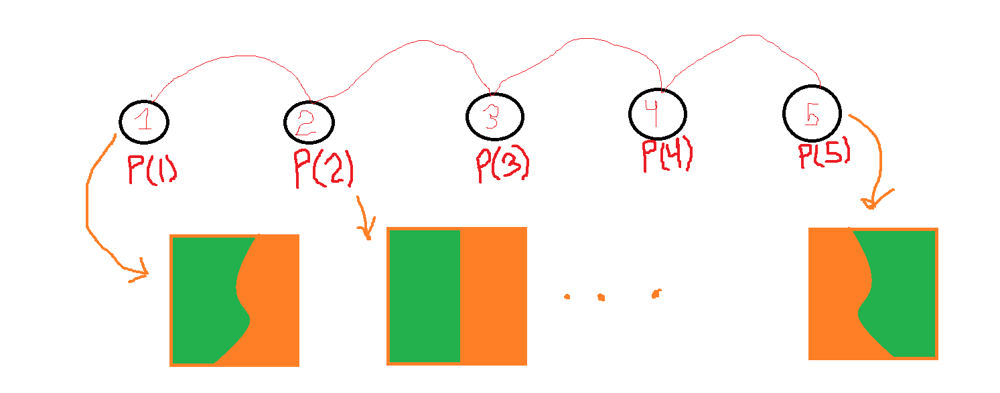

Ahora pensemos que un sistema tiene muchos estados posibles. Podemos brincar de uno estado $j$ a otro $i$ con cierta probabilidad condicional $p(i|j)$. ¿Cuál es la probabilidad de que comencemos en el estado $j$ y de ahí pasemos al estado $i$? Estar en el estado $j$ tiene la probabilidad $p(j)$ y de ahí pasar al estado $i$ tiene la probabilidad $p(i|j)$. Por lo tanto, comenzar en $j$ y pasar a $i$ tiene la probabilidad $p(j)p(i|j)$, pues ambas probabilidades son independientes. Si tenemos un sistema en equilibrio, significa que es reversible y por lo tanto la probabilidad de que se comience en el estado $i$ y después se pase al estado $j$ es igual a que se comience en $j$ y se pase a un estado $i$, es decir: 

$$p(j)p(i|j) = p(i)p(j|i).$$

Esta condición se conoce como balance detallado y esperamos que la cumplan todos los sistemas en equilibrio si la probabilidad de estar en el estado $i$ sólo depende del estado anterior en el que se estuvo (a estos sistemas se les conoce como cadenas de Markov). 



Esta condición de balance detallado se puede escribir como: 

$$ \frac{p(i|j)}{p(j|i)} = \frac{p(i)}{p(j)}$$ 

Notemos que si elegimos $p(i|j) = min(1, p(i)/p(j))$ se cumple la ecuación de balance detallado, pues si $p(i)/p(j)<1$, entonces $p(i|j) = p(i)/p(j)$ y $p(j|i) = 1$, si $p(i)/p(j)>1$ entonces $p(j|i) = p(j)/p(i)$ y $p(i|j) = 1$ . 

### Termodinámica

Una de las ecuaciones más importantes en física, es la de la distribución de Boltzmann de las energías $H$: 

$$\rho(H) = \frac{1}{Z}e^{-H/k_BT},$$ 

donde $T$ es la temperatura del sistema y $k_B$ es la constante de Boltzmann y $Z$ es alguna función de $T$, $V$ y $N$, pero no depende de $H$ (es conocida como función de partición). Esta ecuación nos dice cómo está distribuida la energía en las partículas de un sistema, lo que por ejemplo nos lleva a que la distribución de velocidades de un gas ideal es: $\rho(v) = \left(\frac{m}{2\pi k_B T}\right)^{3/2} v^2 e^{-mv^2 /2k_BT}$ 


In [87]:
boltzmann(v, kT, m) = 4π*v^2 *(m/(2π*kT))^(3/2)*exp(-m*v^2 /(2kT))
plot()
@manipulate for Temperatura in -10:35, masas_virales in 1:1000, reset = [true, false]
    if reset
        plot()
    end 
    m = 1e-19*masas_virales
    kT = (Temperatura+273.16)* 1.38e-23
    boltzmann(v) = 4π*v^2 *(m/(2π*kT))^(3/2)*exp(-m*v^2 /(2kT))
    v = 0:0.001:0.7
    plot!(v, boltzmann.(v), key = false, xlabel = L"v (m/s)", ylabel = L"\rho(v)", ylim = (0,100))
end

Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Scope(Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :label), Any["Temperatura"], Dict{Symbol, Any}(:className => "interact ", :style => Dict{Any, Any}(:padding => "5px 10px 0px 10px")))], Dict{Symbol, Any}(:className => "interact-flex-row-left")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :input), Any[], Dict{Symbol, Any}(:max => 35, :min => -10, :attributes => Dict{Any, Any}(:type => "range", Symbol("data-bind") => "numericValue: index, valueUpdate: 'input', event: {change: function (){this.changes(this.changes()+1)}}", "orient" => "horizontal"), :step => 1, :className => "slider slider is-fullwidth", :style => Dict{Any, Any}()))], Dict{Symbol, Any}(:className => "interact-flex-row-center")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :p), Any[], Dict{Symbol, Any}(:attributes => Dict("data-bind" => "text: formatted_val")))], Dict{Symbol, Any}(:className => "interact-flex-row-right"))], Dict{Symbol, Any}(:className => "interact-flex-row interact-widget")), Dict{String, Tuple{Observables.AbstractObservable, Union{Nothing, Bool}}}("changes" => (Observable{Int64} with 1 listeners. Value:
0, nothing), "index" => (Observable{Int64} with 2 listeners. Value:
12, nothing)), Set{String}(), nothing, Asset[Asset("js", "knockout", "C:\\Users\\ata0k\\.julia\\packages\\Knockout\\IP1uR\\src\\..\\assets\\knockout.js"), Asset("js", "knockout_punches", "C:\\Users\\ata0k\\.julia\\packages\\Knockout\\IP1uR\\src\\..\\assets\\knockout_punches.js"), Asset("js", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\all.js"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\style.css"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\Interact\\SbgIk\\src\\..\\assets\\bulma_confined.min.css")], Dict{Any, Any}("changes" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"changes\"]()) ? (this.valueFromJulia[\"changes\"]=true, this.model[\"changes\"](val)) : undefined})")], "index" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"index\"]()) ? (this.valueFromJulia[\"index\"]=true, this.model[\"index\"](val)) : undefined})")]), WebIO.ConnectionPool(Channel{Any}(32), Set{AbstractConnection}(), Condition(Base.InvasiveLinkedList{Task}(Task (runnable) @0x00000000809204c0, Task (runnable) @0x00000000809204c0), Base.AlwaysLockedST(1))), WebIO.JSString[WebIO.JSString("function () {\n    var handler = (function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init: function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            });\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            });\n            ko.applyBindingsToNode(\n                element,\n                {\n                    value: stringified,\n                    valueUpdate: allBindings.get('valueUpdate'),\n                },\n                context,\n            );\n        }\n    };\n    var json_data = {\"formatted_vals\":[\"-10\",\"-9\",\"-8\",\"-7\",\"-6\",\"-5\",\"-4\",\"-3\",\"-2\",\"-1\",\"0\",\"1\",\"2\",\"3\",\"4\",\"5\",\"6\",\"7\",\"8\",\"9\",\"10\",\"11\",\"12\",\"13\",\"14\",\"15\",\"16\",\"17\",\"18\",\"19\",\"

El problema de la distribución de Boltzmann es que no es fácil calcular $Z$. Esto queda resueltu cuando se supone verdadera la ecuación de balance detallado, pues queda como: 

$$ \frac{p(i|j)}{p(j|i)}  = e^{-\Delta H/k_BT},$$

donde $\Delta H = H_i -H_j$ es la diferencia de energías en los dos estados. Eligiendo en este caso $p(i|j) = min(1, e^{-\Delta H/k_BT})$, se cumple la ecuación de balance detallado, por lo que esperamos que dado un estado inicial, se visiten todos los estados del sistema generando una distribución de probabilidad igual a $\rho(H)$ (se visitarán más los estados más probables y menos los menos probables). 

### Algoritmo

**Nota:** De forma general podemos elegir $p(i|j) = min(1, p(i)/p(j))$, con alguna otra distribución que no sea la distribución de Boltzmann, sin embargo es muy frecuentemente una buena distribución (ya verán porque en su curso de física estadística), así que será la que usaremos. 

Ya tenemos una probabilidad para cambiar de un estado a otro. El algoritmo de Metrópolis consiste en comenzar con un estado cualquiera, proponer un nuevo estado y decidir si se cambia o no al nuevo estado con probabilidad $p(i|j)$. Entonces, el algoritmo completo es: 

**Input:** Hamiltoniano $H(\sigma)$, estado inicial $\sigma_0$,  número de pasos $n$.  

1. Para $i \in [0,1,\dots, n-1]$ Se elige entre un conjunto de estados posibles y diferentes a $\sigma_{i}$ un posible estado $\sigma_{i+1}'$. 
    * Se calcula $p = p(\sigma_{i+1}'| \sigma_i) = min(1, e^{-\Delta H/k_BT})$ 
    * Se genera un número aleatorio $x$ con distribución uniforme entre $0$ y $1$. Si $x<p$ entonces $\sigma_{i+1} \rightarrow \sigma_{i+1}'$ si no, entonces $\sigma_{i+1} \rightarrow \sigma_i$. 
2. Se regresa el arreglo de todos los estados $\sigma_i$. 

Aquí es importante mencionar que frecuentemente se puede calcular $\Delta H$ sin necesidad de calcular $H(\sigma_i)$ y $H(\sigma_{i+1})$. 

También es frecuente que uno no elija entre todos los posibles estados, sino sólo sobre algunos. Por ejemplo, cuando se tienen muchas partículas, en vez de cambiar el estado de varias partículas, es frecuente elegir sólo una partícula a la que se le cambia el estado en cada paso. Esto hace que con frecuencia $\Delta H$ sea sólo el cambio en la energía de la partícula que se movió y con las que interacciona antes y después del cambio. 

<br>
<br>
<br>
<br>
<br>
<br>

### Ejemplo 1: Fluido de esferas duras: 

Las esferas duras tienen un potencial de interacción $
U(r)=
\begin{cases}
0, & \text{para } r>\sigma\\
\infty & \text{para } r \le \sigma
\end{cases}.
$
Por lo tanto $ p(\sigma_{i+1}'| \sigma_i) = min(1, e^{-\Delta H/k_BT})$ la probabilidad de estar en el nuevo estado es $0$ si en el nuevo estado se enciman dos esferas ($\Delta H = \infty \Rightarrow  e^{-\infty/k_BT} = 0$) y $1$ si no se enciman. 

En este caso, salvo cuando $T = 0$, no importa qué temperatura se tenga. Esto de hecho genera un problema en las simulaciones de esferas duras para definir la temperatura, por lo que típicamente en lugar de usar la temperatura como parámetro, se utiliza la densidad de partículas (o equivalentemente, la fracción de empaquetamiento). 

Para hacer animaciones bonitas y claras, voy a comenzar definiendo el objeto Disco y como graficarlo:

In [88]:
mutable struct Disco
    radio::Real
    posición::Vector
    color
end

In [89]:
using Colors, LinearAlgebra
import Plots.plot!
function plot!(disco::Disco)
    θ = 0:0.05:(2π+0.05)
    x = disco.radio*(cos.(θ)).+disco.posición[1]
    y = disco.radio*(sin.(θ)).+disco.posición[2]
    plot!(x,y, fill = true, color = disco.color)
end

plot! (generic function with 5 methods)

El siguiente paso es hacer una función que reconozca cuando de entre un conjunto de discos, alguno se encima. Con esto sabemos que si hay un disco que se encime en una nueva configuración, tenemos que regresar un paso atrás. 

También necesitaremos generar una configuración inicial y para ello requerimos poner muchos discos "aleatoriamente". Aquí debo decir que la forma correcta de poner las condiciones iniciales podría pensarse que es ir poniendo uno a uno discos aleatoriamente y cuando uno se encima con el resto, se retira y se pone uno nuevo. Esta forma de generar configuraciones iniciales no es correcta, pues da preferencia a ciertas configuraciones sobre otras. Hacerlo correctamente puede ser extremadamente complicado. Aquí seguiremos una estrategia simple, aunque poco eficiente. 

Comensaremos por poner discos de radio 0 aleatoriamente. Estos no se enciman, así que no es problema. Luego, aplicaremos el algoritmo de Metrópolis para mover los discos, pero también para crecerlos. Es decir, uno de los posibles pasos de Monte-Carlo es crecer todos los discos alguna cantidad. 

El primer paso es entonces una función para reconocer si los discos se enciman o no. Vale la pena hacer 2 funciones, una que tenga como argumentos todos los discos, otra que tenga como argumentos todos los discos y uno que se mueve. 

In [90]:
function overlap(discos)
    n = length(discos)
    for i in 1:n-1
        for j in i+1:n
            if norm(discos[i].posición-discos[j].posición)<discos[i].radio+discos[j].radio
                return true
            end
        end
    end
    for i in 1:n
        if discos[i].posición[1]<discos[i].radio || discos[i].posición[1]> 15-discos[i].radio || discos[i].posición[2]<discos[i].radio || discos[i].posición[2]>15-discos[i].radio 
            return true
        end
    end
    return false
end

function overlap(discos, i)
    disco = discos[i]
    n = length(discos)
    if disco.posición[1]<disco.radio || disco.posición[1]> 15-disco.radio || disco.posición[2]<disco.radio || disco.posición[2]>15-disco.radio
        return true
    end
    for j in (1:(i-1))∪((i+1):length(discos))
        if norm(discos[j].posición-disco.posición)<discos[j].radio+disco.radio
            return true
        end
    end
    return false
end

overlap (generic function with 2 methods)

Ahora generamos el arreglo de discos de radio 0

In [ ]:
discos = []
for i in 1:50
    d = Disco(0.,rand(2)*15, RGB(0.8,0.5,0.2))
    push!(discos, d)
end
length(discos)

Ahora sí, la simulación, que consiste en ir moviendo disco por disco y revisar si se encima con algún otro. Si al mover el disco, hay discos que se enciman, entonces regresamos a la configuración anterior. Si no se enciman los discos, entonces dejamos esta última como la nueva configuración. 

Además agregamos la posibilidad de comprimir el sistema o equivalentemente incrementar el radio de las partículas. 

In [91]:
function simulacion_MC_discos_duros!(discos, pasos = length(discos)*100, δx = 0.05)
    nd = length(discos)
    discos2 = deepcopy(discos)
    D = [discos2]
    for i in 1:pasos
        if mod(i, 5000) == 0
            println(i*100/pasos, " %")
        end
        discos2 = deepcopy(discos)
        test = rand([true, false, false, false])
        if test
            
            for k in 1:nd
                discos2[k].radio += 0.001
            end
            if overlap(discos2)
        #        push!(D, deepcopy(discos))
            else
                discos = deepcopy(discos2)
                push!(D, deepcopy(discos2))
            end
            continue
        end
        j = rand(1:nd)
        θ = rand()*2*π
        x = δx*[cos(θ), sin(θ)]
        discos2[j].posición .+= x
        if overlap(discos2, j)
    #        push!(D, deepcopy(discos))
            continue
        else 
            discos[j] = deepcopy(discos2[j])
            push!(D, deepcopy(discos))
        end   
        
    end
    return D
end

simulacion_MC_discos_duros! (generic function with 3 methods)

In [92]:
discos = []
for i in 1:100
    d = Disco(0.,rand(2)*15, RGB(0.1,0.8,0.4))
    push!(discos, d)
end
length(discos)
@time D = simulacion_MC_discos_duros!(discos, 2500000);
discos = deepcopy(D[end]);

0.2 %
0.4 %
0.6 %
0.8 %
1.0 %
1.2 %
1.4 %
1.6 %
1.8 %
2.0 %
2.2 %
2.4 %
2.6 %
2.8 %
3.0 %
3.2 %
3.4 %
3.6 %
3.8 %
4.0 %
4.2 %
4.4 %
4.6 %
4.8 %
5.0 %
5.2 %
5.4 %
5.6 %
5.8 %
6.0 %
6.2 %
6.4 %
6.6 %
6.8 %
7.0 %
7.2 %
7.4 %
7.6 %
7.8 %
8.0 %
8.2 %
8.4 %
8.6 %
8.8 %
9.0 %
9.2 %
9.4 %
9.6 %
9.8 %
10.0 %
10.2 %
10.4 %
10.6 %
10.8 %
11.0 %
11.2 %
11.4 %
11.6 %
11.8 %
12.0 %
12.2 %
12.4 %
12.6 %
12.8 %
13.0 %
13.2 %
13.4 %
13.6 %
13.8 %
14.0 %
14.2 %
14.4 %
14.6 %
14.8 %
15.0 %
15.2 %
15.4 %
15.6 %
15.8 %
16.0 %
16.2 %
16.4 %
16.6 %
16.8 %
17.0 %
17.2 %
17.4 %
17.6 %
17.8 %
18.0 %
18.2 %
18.4 %
18.6 %
18.8 %
19.0 %
19.2 %
19.4 %
19.6 %
19.8 %
20.0 %
20.2 %
20.4 %
20.6 %
20.8 %
21.0 %
21.2 %
21.4 %
21.6 %
21.8 %
22.0 %
22.2 %
22.4 %
22.6 %
22.8 %
23.0 %
23.2 %
23.4 %
23.6 %
23.8 %
24.0 %
24.2 %
24.4 %
24.6 %
24.8 %
25.0 %
25.2 %
25.4 %
25.6 %
25.8 %
26.0 %
26.2 %
26.4 %
26.6 %
26.8 %
27.0 %
27.2 %
27.4 %
27.6 %
27.8 %
28.0 %
28.2 %
28.4 %
28.6 %
28.8 %
29.0 %
29.2 %
29.4 %
29.6 %
29.8 %
30.0 %

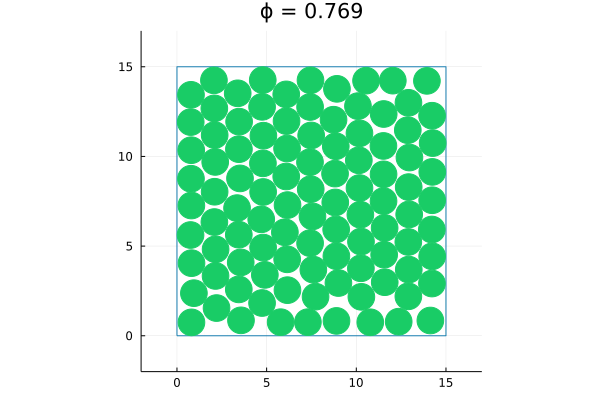

Animation("C:\\Users\\ata0k\\AppData\\Local\\Temp\\jl_EhLQer", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000696.png", "000697.png", "000698.png", "000699.png", "000700.png", "000701.png", "000702.png", "000703.png", "000704.png", "000705.png"])

In [93]:
discos_duros = @animate for i in 1:1000:length(D)
    plot(aspect_ratio = :equal, key = false, xlim = (-2,17), ylim = (-2,17))
    plot!([0,15,15,0,0], [0,0,15,15,0], color = RGB(0.1,0.5,0.7))
    for j in 1:length(D[1])
        plot!(D[i][j])
    end
    plot!(show = :ijulia, title = "ϕ = $(round(100*π*D[i][1].radio^2/15^2, digits = 3))")
end

┌ Info: Saved animation to 
│   fn = D:\Cursos\Fisica-Computacional-2021-2\Discos_duros.gif
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\animation.jl:104


Plots.AnimatedGif("D:\\Cursos\\Fisica-Computacional-2021-2\\Discos_duros.gif")
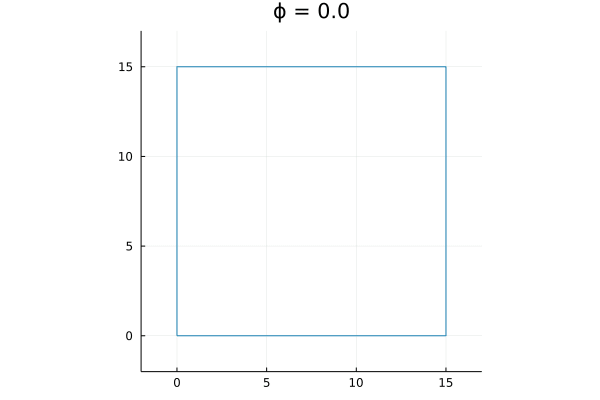

In [94]:
gif(discos_duros, "Discos_duros.gif", fps = 24)

Para terminar esta parte, quiero mencionar que aunque el algoritmo de Metrópolis es bueno, desperdiciamos mucho tiempo de cómputo buscando las interacciones entre las partículas, cuando sabemos que en realidad en cada paso de Monte-Carlo, no necesitaríamos revisar si hay intersección con todas las partículas, sino sólo con las cercanas, pues los movimientos/crecimientos no son arbitrariamente grandes. 

La simulación que aquí les presento, tomó $\sim 20$min para sólo 100 discos y el tiempo de cómputo crece cuadráticamente con el número de partículas. Para simular $10^5$ discos (en eso rondan las simulaciones hoy en día, algunas incluso llegan a $10^6$ partículas), se requerirían 38 años!! Por supuesto, no es algo factible, pero hay formas de reducir ese tiempo de cómputo considerablemente (a un par de semanas). Esto será el tema del siguiente y último notebook del curso. Por ahora veremos un ejemplo más del algoritmo de Metrópolis. 

<br>
<br>
<br>
<br>
<br>
<br>

### Ejemplo 2: Modelo de Ising

A principios del siglo pasado, Lenz le propuso a un alumno suyo un modelo del ferromagnetismo muy sencillo que consistía en una red de átomos que fueran como pequeños imanes (debido al espín). Cada átomo en esta red interactuaría sólo con sus vecinos mediante el siguiente Hamiltoniano (energía). 

$$H(\vec{\sigma}) = -h\sum_i \sigma_i - J \sum_{<i, j>} \sigma_i \sigma_j$$

Donde $\vec{\sigma}$ es la configuración de espines normalizados, es decir, un arreglo de $1$'s y $-1$'s, $h$ es el campo magnético y $J$ es la energía de enlace y $<i,j>$ signfica que la suma se da sobre los pares $i$ y $j$ que son vecinos en la retícula. 

El modelo lo resolvió Ising con una cadena lineal de espines y no encontró nada interesante. Después, de eso, parte de su vida la dedicó a huir de los problemas de la segunda guerra mundial (era Judío en Alemania) y el resto lo dedicó a la enseñanza a nivel secundaria (vivió 98 años). 

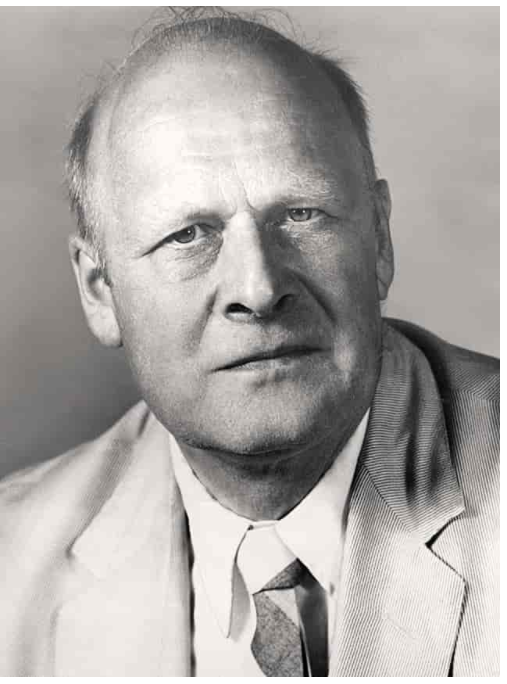

En los años 40's, sin embargo, Onsager retomó el trabajo de Ising para hacer la versión 2D al menos cuando $h = 0$. El modelo era aburrido en 1D, pero en 2D automáticamente se vuelve interesante y un buen modelo del ferromagnetismo y diamagnetismo. El problema es que las soluciones analíticas son en extremo complicadas o de plano imposibles. Por eso es necesario estudiarlo numéricamente. 

La ventaja de este modelo en la simulación, es que a diferencia de las esferas duras está bien definido quién es vecino de quién, es decir, para cada partícula sólo nos tenemos que fijar en sus $n$ vecinos, que en el caso de una red cuadrada son 4. La "desventaja" es que la energía no es $0$ o $\infty$, y por lo tanto la probabilidad de cambiar es realmente $min(1, e^{-\Delta H/k_BT})$. Esto hace que la temperatura sea realmente un parámetro que manipular aquí. 

Resolvamos el modelo para la red cuadrada vía el algoritmo de Metrópolis. 

El primer paso es generar la red cuadrada de $n\times m$ y conocer quienes son sus vecinos. Para hacerlo un poco más rápido (aunque el código sea un poco más largo), conviene que el arreglo $\vec{\sigma}$ sea un arreglo de 1 dimensión de tamaño $n\cdot m$, donde el primer elemento representa el vértice $(1,1)$, el $(j-1)\cdot n+i$ el emento representa el vértice $(i,j)$. La dificultad entonces consiste en encontrar qué elementos de $\vec{\sigma}$ son vecinos. Para esto haremos una función que arroje un arreglo de $n\cdot m$ elementos, donde el elemento $i$ es un arreglo que contiene números enteros que representan los índices de los vecinos de $\sigma_i$. 

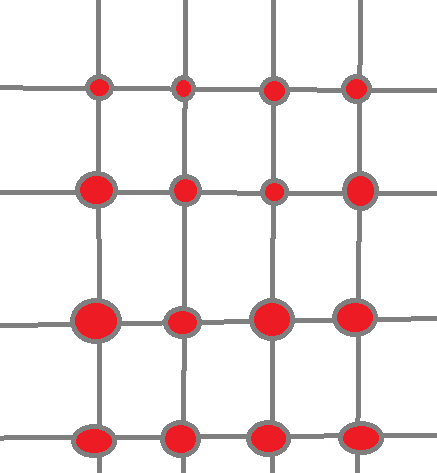

In [1]:
function jj(i,n,m)
    mod(floor(Int,(i-1)/n), m)
end
    
function vecinos(n,m)  
    [[mod1(i-1, n)+jj(i,n,m)*n, mod1(i+1, n)+jj(i,n,m)*n,
       mod1(i, n)+mod((jj(i,n,m)-1),m)*n, mod1(i, n)+mod((jj(i,n,m)+1),m)*n] for i in 1:n*m]
end  
# Esta retícula tiene condiciones periódicas a la frontera que se ven en las funciones mod1 y mod. 

vecinos (generic function with 1 method)

Ok, ya tenemos la red vía los vecinos de cada nodo. El siguiente paso es una función para calcular la energía del sistema dada una configuración. Y también una para calcular directamente $\Delta H$ dado que se modifica sólo 1 espín. 

In [2]:
function suma(σ, vecinos1) 
    s = 0
    for i in 1:length(σ)
        s += sum(σ[vecinos1[i]])*σ[i]
    end
    return s
end
H(σ, vecinos1; h = 0, J = 1) = -h*sum(σ) - J*suma(σ, vecinos1) 

H (generic function with 1 method)

Al modificar un solo espín del arreglo, básicamente todo se queda igual en $H$, excepto por $h\sigma_i$ y los enlaces entre los vértices $i$ y sus vecinos. La diferencia por $h\sigma_i$ es $2h$ si $sigma_i$ se vuelve positivo y $-2h$ si se vuelve negativo, es decir, $H$ se actualiza sumando $h\sigma_i$ con $\sigma_i$ el nuevo valor. En el caso de los vecinos por cada enlace hay dos productos, el de $\sigma_i \sigma_j$ y el de $\sigma_j \sigma_i$. Por lo tanto, la diferencia en el hamiltoniano por cada enlace va a ser de $4\sigma_i \sigma_j$ 

In [3]:
function ΔH(σ, i, vecinos1; h = 0, J = -1)
    s = 2h*σ[i] 
    s += 4J*σ[i]*sum(σ[vecinos1[i]])
    return s
end

ΔH (generic function with 1 method)

In [4]:
n,m = 500,500
vecinosnm = vecinos(n,m)
σ = rand([-1,1], n*m)
H1 = H(σ, vecinosnm; h = 0, J = 1)
σ2 = copy(σ)
σ2[1] *= -1
H2 = H(σ2, vecinosnm; h = 0, J = 1)
H2-H1, ΔH(σ, 1, vecinosnm, J = 1, h = 0)

(-8, -8)

In [5]:
@time begin
    H1 = H(σ, vecinosnm, J = -1)
    H2 = H(σ2, vecinosnm, J = -1)
    H2-H1
end

  0.132788 seconds (505.70 k allocations: 53.788 MiB, 66.28% gc time, 3.80% compilation time)


8

In [6]:
@time ΔH(σ, 1, vecinosnm, J = -1)

  0.004961 seconds (3.99 k allocations: 265.229 KiB, 99.51% compilation time)


8

Calcular $\Delta H$ lleva un tiempo constante, mientras que $H_2 -H_1$ lleva un tiempo proporcional a $n\cdot m$. Por lo tanto vale mucho la pena calcular $\Delta H$ directamente! 

Finalmente, aplicamos el algoritmo de Metrópolis

In [7]:
function Boltzmann(Δ𝐻, 𝑘𝑇) 
    if Δ𝐻 == 0
        return 1
    else
        return min(1,exp(-Δ𝐻/𝑘𝑇))
    end
end
function Metropolis_ising!(σ, vecinos1, n, m, H1; n_pasos = 1, kT = 1, kargs...)
    l = length(σ)
    centro_material = [i*n+1+j for i in 1:m-2, j in 1:n-2]
    mag = 0
    for i in 1:n_pasos
        j = rand(centro_material)
        ΔH1 = ΔH(σ, j, vecinos1; kargs...)
        p = Boltzmann(ΔH1, kT)
        x = rand()
        if x<p
            σ[j] *= -1
        end
        if i > n_pasos-1000
            mag += sum(σ)/l
        end
        H1 += ΔH1
    end
    return σ, H1, mag/1000
end

Metropolis_ising! (generic function with 1 method)

Para ver cómo funciona, vale la pena graficar el material, así que haremos una función para graficarlo.

In [11]:
using Plots, Colors

In [12]:
plot_sigma(σ, n, m, color = RGB(1,1,1)) = heatmap(reshape(σ, m,n), color = [RGB(0,0,0), color], aspect_ratio = 1, cbar = false, grid = false, axis = false, ticks = false)

plot_sigma (generic function with 2 methods)

Y de paso usemos Interact para poder jugar un poco con el código: 

In [13]:
using Interact

HTML{String}("<script>\n// Immediately-invoked-function-expression to avoid global variables.\n(function() {\n    var warning_div = document.getElementById(\"webio-warning-8635340693269797753\");\n    var hide = function () {\n        var script = document.getElementById(\"webio-setup-13993087677029893418\");\n        var parent = script && script.parentElement;\n        var grandparent = parent && parent.parentElement;\n        if (grandparent) {\n            grandparent.style.display = \"none\";\n        }\n        warning_div.style.display = \"none\";\n    };\n    if (typeof Jupyter !== \"undefined\") {\n        console.log(\"WebIO detected Jupyter notebook environment.\");\n        // Jupyter notebook.\n        var extensions = (\n            Jupyter\n            && Jupyter.notebook.config.data\n            && Jupyter.notebook.config.data.load_extensions\n        );\n        if (extensions && extensions[\"webio-jupyter-notebook\"]) {\n            // Extension already loaded.\n            console.log(\"Jupyter WebIO nbextension detected; not loading ad-hoc.\");\n            hide();\n            return;\n        }\n    } else if (window.location.pathname.includes(\"/lab\")) {\n        // Guessing JupyterLa\n        console.log(\"Jupyter Lab detected; make sure the @webio/jupyter-lab-provider labextension is installed.\");\n        hide();\n        return;\n    }\n})();\n\n</script>\n<p\n    id=\"webio-warning-8635340693269797753\"\n    class=\"output_text output_stderr\"\n    style=\"padding: 1em; font-weight: bold;\"\n>\n    Unable to load WebIO. Please make sure WebIO works for your Jupyter client.\n    For troubleshooting, please see <a href=\"https://juliagizmos.github.io/WebIO.jl/latest/providers/ijulia/\">\n    the WebIO/IJulia documentation</a>.\n    <!-- TODO: link to installation docs. -->\n</p>\n")

In [14]:
boton1 = textbox(value = "5")
barra1 = slider(0:0.01:2,label = "h", value = 0)
barra2 = slider(0:0.01:8,label = "kT", value = 0)
barra3 = textbox(value = "1")
barra4 = slider(-1:0.02:1,label = "J", value = 0.5)
boton2 = button("reset")
botones = OrderedDict(:boton_L => boton1, :barra_h => barra1,:barra_kT => barra2, 
     :boton_r => boton2,:barra_J => barra4, :barra_t => barra3, :colores => colorpicker(value = RGB(0.3, 0.7, 0.9)))
w = Interact.Widget{:mi_widget}(botones);

@layout! w vbox(hbox(vbox(hbox(latex("L = "), :boton_L), :boton_r, :colores), vbox( :barra_h, :barra_kT, :barra_J)), vbox(hbox("tiempo de animación = ", :barra_t)))

Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Scope(Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[], Dict{Symbol, Any}(:id => "container")), Dict{String, Tuple{Observables.AbstractObservable, Union{Nothing, Bool}}}("value" => (Observable{String} with 1 listeners. Value:
"L = ", nothing)), Set{String}(), nothing, Asset[Asset("js", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\katex.min.js"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\katex.min.css")], Dict{Any, Any}("value" => Any[WebIO.JSString("(function (txt){return this.k.render(txt,this.container)})")]), WebIO.ConnectionPool(Channel{Any}(32), Set{AbstractConnection}(), Condition(Base.InvasiveLinkedList{Task}(nothing, nothing), Base.AlwaysLockedST(1))), WebIO.JSString[WebIO.JSString("function () {\n    var handler = ((function (k){this.k=k; this.container=this.dom.querySelector(\"#container\"); return k.render(\"L = \",this.container)}));\n    (WebIO.importBlock({\"data\":[{\"name\":null,\"type\":\"js\",\"url\":\"/assetserver/2e767843c021300bb89decd4f368beb184f3cfed-katex.min.js\"},{\"name\":null,\"type\":\"css\",\"url\":\"/assetserver/a1488d53ab230156b31ed640b3881976c10d18c1-katex.min.css\"}],\"type\":\"async_block\"})).then((imports) => handler.apply(this, imports));\n}\n")])], Dict{Symbol, Any}(:className => "interact-widget")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Scope(Node{WebIO.DOM}(WebIO.DOM(:html, :input), Any[], Dict{Symbol, Any}(:attributes => Dict{Any, Any}(:type => "text", Symbol("data-bind") => "value: value, valueUpdate: 'input', event: {change: function (){this.changes(this.changes()+1)}}"), :placeholder => "", :className => "input ", :style => Dict{Any, Any}())), Dict{String, Tuple{Observables.AbstractObservable, Union{Nothing, Bool}}}("changes" => (Observable{Int64} with 1 listeners. Value:
0, nothing), "value" => (Observable{String} with 1 listeners. Value:
"5", nothing)), Set{String}(), nothing, Asset[Asset("js", "knockout", "C:\\Users\\ata0k\\.julia\\packages\\Knockout\\IP1uR\\src\\..\\assets\\knockout.js"), Asset("js", "knockout_punches", "C:\\Users\\ata0k\\.julia\\packages\\Knockout\\IP1uR\\src\\..\\assets\\knockout_punches.js"), Asset("js", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\all.js"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\style.css"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\Interact\\SbgIk\\src\\..\\assets\\bulma_confined.min.css")], Dict{Any, Any}("changes" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"changes\"]()) ? (this.valueFromJulia[\"changes\"]=true, this.model[\"changes\"](val)) : undefined})")], "value" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"value\"]()) ? (this.valueFromJulia[\"value\"]=true, this.model[\"value\"](val)) : undefined})")]), WebIO.ConnectionPool(Channel{Any}(32), Set{AbstractConnection}(), Condition(Base.InvasiveLinkedList{Task}(Task (runnable) @0x000000001b1a6ef0, Task (runnable) @0x000000001b1a6ef0), Base.AlwaysLockedST(1))), WebIO.JSString[WebIO.JSString("function () {\n    var handler = (function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init: function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            });\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\

In [15]:
function plot_final(σ, n, time, magnetización, color, t)
    plot_sigma(σ, n, n, color)
    p1 = plot!(title = "$(time[end])")
    p2 = plot(time, abs.(magnetización), key = false, xlim = (0,t), ylim = (0,1), title = "magnetización = $(round(magnetización[end], digits = 3))")
    plot(p1,p2)
end

function animacion_interactiva(L, kT, J, h, t, color)
    vecinosnm = vecinos(L,L)
    σ = rand([-1,1], L^2)
    σ[1:L] = ones(L)
    σ[1:L:(L-1)*L+1] = ones(L)
    σ[L:L:L^2] = ones(L)
    σ[L*(L-1)+1:L^2] = ones(L)
    H1 = H(σ, vecinosnm)
    magnetización = []
    @gif for i in 1:t
        time = 1:i
        σ, H1, mag = Metropolis_ising!(σ, vecinosnm, L,L, H1, n_pasos = 10L^2, kT = kT, h = h, J = J)
        push!(magnetización, mag)
        plot_final(σ, L, time, magnetización, color, t)
    end
end

function np(n,m)
    return n
end

np (generic function with 1 method)

In [16]:
gr()
animacion = map(animacion_interactiva, 
    map(np, map(x-> parse(Int, x), botones[:boton_L]), botones[:boton_r]), 
    botones[:barra_kT], 
    botones[:barra_J],
    botones[:barra_h],
    map(x-> parse(Int, x), botones[:barra_t]),
    botones[:colores]);

┌ Info: Saved animation to 
│   fn = D:\Cursos\Fisica-Computacional-2021-2\tmp.gif
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\animation.jl:104


In [17]:
hbox(animacion, w) 

(div { style=Dict("display" => "flex", "flex-direction" => "row") }
  Observable{Any} with 0 listeners. Value:
Plots.AnimatedGif("D:\\Cursos\\Fisica-Computacional-2021-2\\tmp.gif")
  Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Scope(Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[], Dict{Symbol, Any}(:id => "container")), Dict{String, Tuple{Observables.AbstractObservable, Union{Nothing, Bool}}}("value" => (Observable{String} with 1 listeners. Value:
"L = ", nothing)), Set{String}(), nothing, Asset[Asset("js", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\katex.min.js"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\katex.min.css")], Dict{Any, Any}("value" => Any[WebIO.JSString("(function (txt){return this.k.render(txt,this.container)})")]), WebIO.ConnectionPool(Channel{Any}(32), Set{AbstractConnection}(), Condition(Base.InvasiveLinkedList{Task}(nothing, nothing), Base.AlwaysLockedST(1))), WebIO.JSString[WebIO.JSString("function () {\n    var handler = ((function (k){this.k=k; this.container=this.dom.querySelector(\"#container\"); return k.render(\"L = \",this.container)}));\n    (WebIO.importBlock({\"data\":[{\"name\":null,\"type\":\"js\",\"url\":\"/assetserver/2e767843c021300bb89decd4f368beb184f3cfed-katex.min.js\"},{\"name\":null,\"type\":\"css\",\"url\":\"/assetserver/a1488d53ab230156b31ed640b3881976c10d18c1-katex.min.css\"}],\"type\":\"async_block\"})).then((imports) => handler.apply(this, imports));\n}\n")])], Dict{Symbol, Any}(:className => "interact-widget")), Node{WebIO.DOM}(WebIO.DOM(:html, :div), Any[Scope(Node{WebIO.DOM}(WebIO.DOM(:html, :input), Any[], Dict{Symbol, Any}(:attributes => Dict{Any, Any}(:type => "text", Symbol("data-bind") => "value: value, valueUpdate: 'input', event: {change: function (){this.changes(this.changes()+1)}}"), :placeholder => "", :className => "input ", :style => Dict{Any, Any}())), Dict{String, Tuple{Observables.AbstractObservable, Union{Nothing, Bool}}}("changes" => (Observable{Int64} with 1 listeners. Value:
0, nothing), "value" => (Observable{String} with 2 listeners. Value:
"5", nothing)), Set{String}(), nothing, Asset[Asset("js", "knockout", "C:\\Users\\ata0k\\.julia\\packages\\Knockout\\IP1uR\\src\\..\\assets\\knockout.js"), Asset("js", "knockout_punches", "C:\\Users\\ata0k\\.julia\\packages\\Knockout\\IP1uR\\src\\..\\assets\\knockout_punches.js"), Asset("js", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\all.js"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\InteractBase\\Zfu5P\\src\\..\\assets\\style.css"), Asset("css", nothing, "C:\\Users\\ata0k\\.julia\\packages\\Interact\\SbgIk\\src\\..\\assets\\bulma_confined.min.css")], Dict{Any, Any}("changes" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"changes\"]()) ? (this.valueFromJulia[\"changes\"]=true, this.model[\"changes\"](val)) : undefined})")], "value" => Any[WebIO.JSString("(function (val){return (val!=this.model[\"value\"]()) ? (this.valueFromJulia[\"value\"]=true, this.model[\"value\"](val)) : undefined})")]), WebIO.ConnectionPool(Channel{Any}(32), Set{AbstractConnection}(), Condition(Base.InvasiveLinkedList{Task}(Task (runnable) @0x000000001b1a6ef0, Task (runnable) @0x000000001b1a6ef0), Base.AlwaysLockedST(1))), WebIO.JSString[WebIO.JSString("function () {\n    var handler = (function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init: function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n 

┌ Info: Saved animation to 
│   fn = D:\Cursos\Fisica-Computacional-2021-2\tmp.gif
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\animation.jl:104
┌ Info: Saved animation to 
│   fn = D:\Cursos\Fisica-Computacional-2021-2\tmp.gif
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\animation.jl:104
┌ Info: Saved animation to 
│   fn = D:\Cursos\Fisica-Computacional-2021-2\tmp.gif
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\animation.jl:104
┌ Info: Saved animation to 
│   fn = D:\Cursos\Fisica-Computacional-2021-2\tmp.gif
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\animation.jl:104
┌ Info: Saved animation to 
│   fn = D:\Cursos\Fisica-Computacional-2021-2\tmp.gif
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\animation.jl:104


Para terminar, haré un promedio de la magnetización como función de la temperatura a partir de simular 30 sistemas diferentes de $100\times 100$. 

In [109]:
MAG = []

Any[]

In [110]:
m,n = 100,100
for caso in 1:30
    if mod(caso, 3) == 0
        @show caso
    end
    vecinosnm = vecinos(n,m)
    σ = rand([-1,1], n*m)
    σ = rand([-1,1], n*m)
    σ[1:n] = ones(n)
    σ[1:n:(n-1)*m+1] = ones(m)
    σ[n:n:n*m] = ones(m)
    σ[n*(m-1)+1:n*m] = ones(n)
    H1 = H(σ, vecinosnm)
    kTf = 6
    Metropolis_ising!(σ, vecinosnm, n,m, H1, n_pasos = 1500*n*m, kT = 0, h = 0.0, J = 1/2)
    magnetización = []
    for kT in 0:0.01:kTf
        σ, H1, mag = Metropolis_ising!(σ, vecinosnm, n,m, H1, n_pasos = 200*n*m, kT = kT, h = 0.0, J = 1/2)
        push!(magnetización, mag)   
    end
    push!(MAG, magnetización)
end

caso = 3
caso = 6
caso = 9
caso = 12
caso = 15
caso = 18
caso = 21
caso = 24
caso = 27
caso = 30


In [111]:
mp = [sum([MAG[j][i] for j in 1:length(MAG)]) for i in 1:length(MAG[1])]

601-element Vector{Float64}:
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
 30.0
  ⋮
  1.4681556000000013
  1.6580706000000007
  1.4553213999999985
  1.5877595999999996
  1.4573940000000007
  1.5486686000000003
  1.5350562
  1.5806810000000011
  1.5050500000000002
  1.517622399999999
  1.5928655999999992
  1.5226258000000008

In [112]:
plotly()
plot(0:0.01:6, mp./30, key = false, xlabel = "kT", ylabel = "m")

┌ Info: For saving to png with the Plotly backend PlotlyBase has to be installed.
└ @ Plots C:\Users\ata0k\.julia\packages\Plots\isZEW\src\backends.jl:373


In [1]:
mutable struct Particle
    posicion::Vector{Real}
    velocidad::Vector{Real}
    radio::Real
    L::Real
    celda::Int
end
function Particle(posicion, velocidad, radio, L)
    n = ceil(L/(2radio))
    l = L/n
    n_x, n_y = ceil(posicion[1]/l), ceil(posicion[2]/l)
    n_celda = Int(n_x + (n_y-1)*n)
    Particle(posicion, velocidad, radio, L, n_celda)
end

Particle

In [4]:
p1 =  Particle(rand(2), rand(2), 0.01, 1)

Particle(Real[0.911895916327679, 0.19029656178267973], Real[0.9395802933463886, 0.48680352717936515], 0.01, 1, 496)

In [6]:
ceil(p1.posicion[2]/0.01)

36.0

In [10]:
function condiciones_inicials_cuadradas(L)
    posiciones = [[0.0, 0.0] for i in 1:L^2]
    velocidades = [[0.0, 0.0] for i in 1:L^2]
    for i in 1:L^2
        posiciones[i] = [mod1(i, L),ceil(i/L)] 
    end
    return posiciones, velocidades
end

condiciones_inicials_cuadradas (generic function with 1 method)

In [14]:
P, V = condiciones_inicials_cuadradas(10)

([[1.0, 1.0], [2.0, 1.0], [3.0, 1.0], [4.0, 1.0], [5.0, 1.0], [6.0, 1.0], [7.0, 1.0], [8.0, 1.0], [9.0, 1.0], [10.0, 1.0]  …  [1.0, 10.0], [2.0, 10.0], [3.0, 10.0], [4.0, 10.0], [5.0, 10.0], [6.0, 10.0], [7.0, 10.0], [8.0, 10.0], [9.0, 10.0], [10.0, 10.0]], [[0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0]  …  [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0], [0.0, 0.0]])

In [17]:
P[11]

2-element Vector{Float64}:
 1.0
 2.0

In [1]:
A = rand(2,2)
b = rand(2)
A\b

2-element Vector{Float64}:
  32.757548604804626
 -24.035758881168267

In [2]:
A^-1 * b

2-element Vector{Float64}:
  32.75754860480463
 -24.035758881168267